In [1]:
from keras.datasets import mnist 
from keras.layers import *
from keras.layers import LeakyReLU
from keras.models import Sequential, Model, load_model
from keras.optimizers import Adam
from tensorflow.keras.preprocessing import image
from tensorflow import keras
from keras.losses import BinaryCrossentropy 

import numpy as np 
import matplotlib.pyplot as plt 
import math
import os
import pickle

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: l

In [2]:
# path='img_align_celeba/img_align_celeba'
# X_Train=[]

# for pic in os.listdir(path):
#     print(pic)
#     pic=os.path.join(path,pic)
#     pic=image.load_img(pic,target_size=(64,64))
#     pic=image.img_to_array(pic)
#     X_Train.append(pic)

In [3]:
# with open('data.pkl', 'wb') as pickle_file:
#     pickle.dump(X_Train, pickle_file)

In [4]:
with open('/kaggle/input/files12/data.pkl', 'rb') as pickle_file:
    X_Train = pickle.load(pickle_file)

In [5]:
X_Train=np.asarray(X_Train,dtype='float32')
X_Train=(X_Train-127.5)/127.5
print(np.min(X_Train))
print(np.max(X_Train))

print(X_Train.shape)

-1.0
1.0
(60000, 64, 64, 3)


In [6]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [7]:
# Generator
generator = Sequential()
generator.add(Dense(8 * 8 * 512, input_shape=(LATENT_DIM,)))
generator.add(Reshape((8, 8, 512)))
generator.add(LeakyReLU(0.2))
generator.add(BatchNormalization())

generator.add(Conv2DTranspose(256, kernel_size=(4, 4), strides=(2, 2), padding='same'))
generator.add(LeakyReLU(0.2))
generator.add(BatchNormalization())

generator.add(Conv2DTranspose(128, kernel_size=(4, 4), strides=(2, 2), padding='same'))
generator.add(LeakyReLU(0.2))
generator.add(BatchNormalization())

generator.add(Conv2DTranspose(64, kernel_size=(4, 4), strides=(2, 2), padding='same'))
generator.add(LeakyReLU(0.2))
generator.add(BatchNormalization())

generator.add(Conv2DTranspose(3, kernel_size=(4, 4), padding='same', activation='tanh'))

generator.compile(loss='binary_crossentropy', optimizer=Adam(lr=2e-4, beta_1=0.5))
generator.summary()

# Discriminator
discriminator = Sequential()
discriminator.add(Conv2D(64, kernel_size=(4, 4), strides=(2, 2), padding='same', input_shape=(64, 64, 3)))
discriminator.add(BatchNormalization())
discriminator.add(LeakyReLU(0.2))

discriminator.add(Conv2D(128, kernel_size=(4, 4), strides=(2, 2), padding='same'))
discriminator.add(BatchNormalization())
discriminator.add(LeakyReLU(0.2))

discriminator.add(Conv2D(128, kernel_size=(4, 4), strides=(2, 2), padding='same'))
discriminator.add(BatchNormalization())
discriminator.add(LeakyReLU(0.2))

discriminator.add(Flatten())
discriminator.add(Dropout(0.3))

discriminator.add(Dense(1, activation='sigmoid'))

discriminator.compile(loss='binary_crossentropy', optimizer=Adam(lr=2e-4, beta_1=0.5))
discriminator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 8, 8, 512)         0         
                                                                 
 batch_normalization (BatchN  (None, 8, 8, 512)        2048      
 ormalization)                                                   
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 256)      2097408   
 nspose)                                                         
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 256)       0

/opt/conda/lib/python3.10/site-packages/keras/optimizers/legacy/adam.py:117: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


In [8]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [9]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = image.array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [10]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [11]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.2096 - g_loss: 0.8790

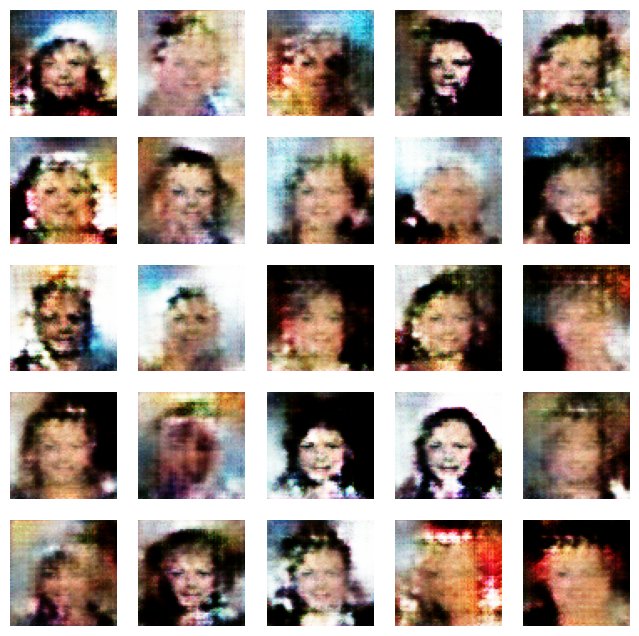

1875/1875 [==============================] - 119s 58ms/step - d_loss: 0.2096 - g_loss: 0.8790
Epoch 2/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.9540 - g_loss: 0.7645

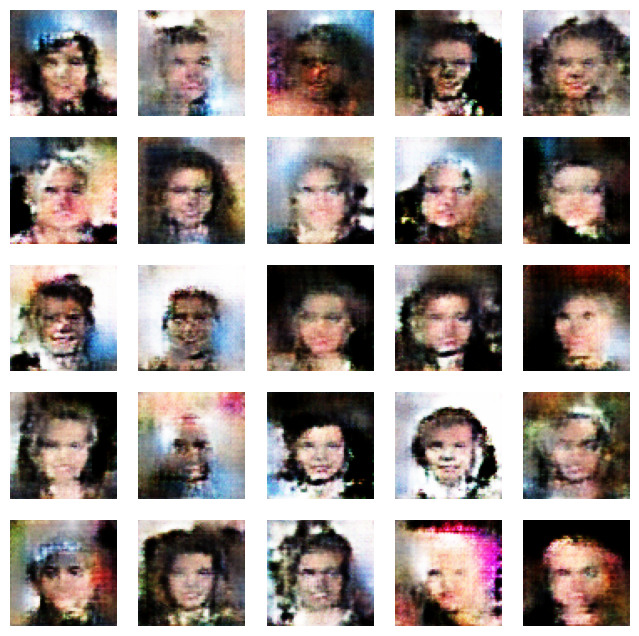

1875/1875 [==============================] - 114s 61ms/step - d_loss: 0.9540 - g_loss: 0.7645
Epoch 3/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.8241 - g_loss: 0.7591

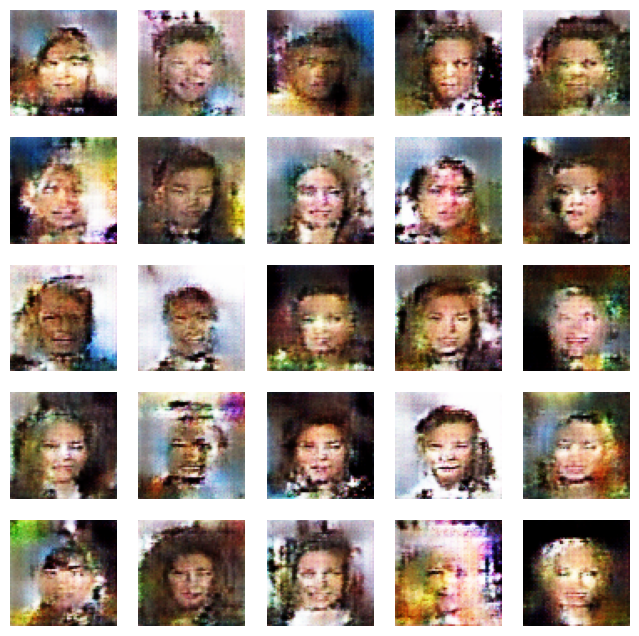

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.8241 - g_loss: 0.7591
Epoch 4/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7706 - g_loss: 0.7462

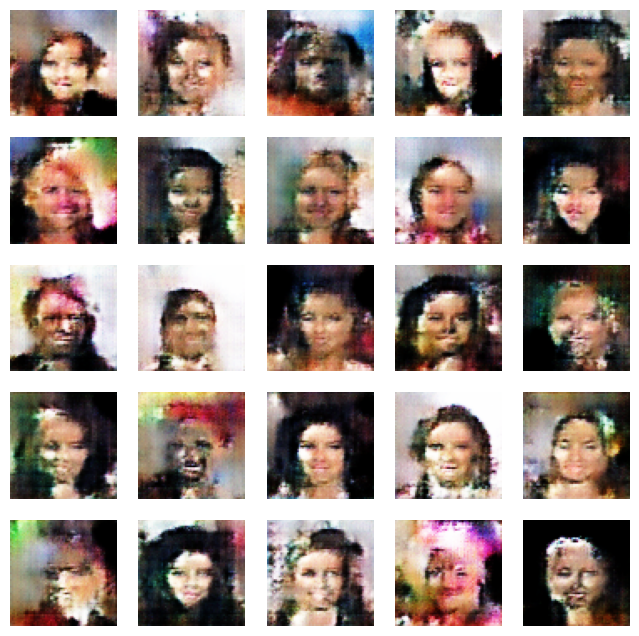

1875/1875 [==============================] - 114s 61ms/step - d_loss: 0.7706 - g_loss: 0.7462
Epoch 5/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7427 - g_loss: 0.7429

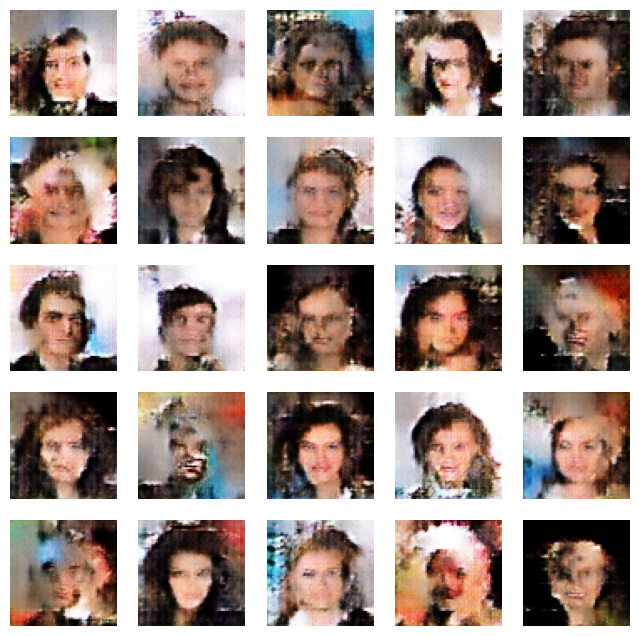

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7427 - g_loss: 0.7429
Epoch 6/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7282 - g_loss: 0.7224

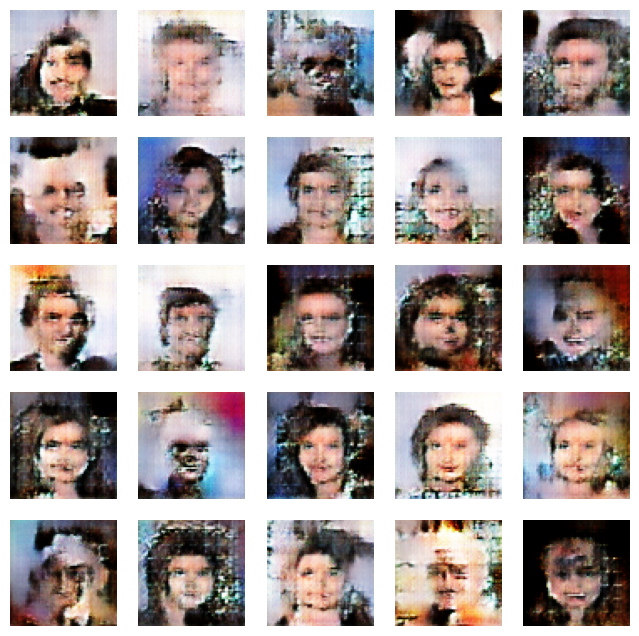

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7282 - g_loss: 0.7224
Epoch 7/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7184 - g_loss: 0.7179

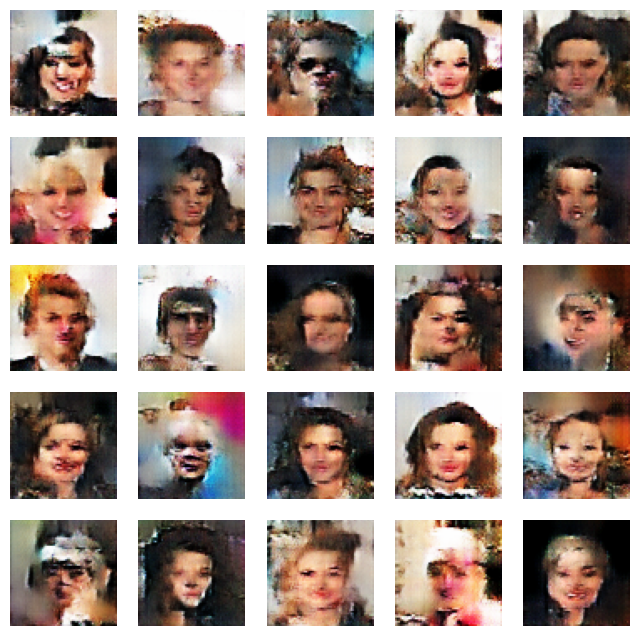

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7184 - g_loss: 0.7179
Epoch 8/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7154 - g_loss: 0.7049

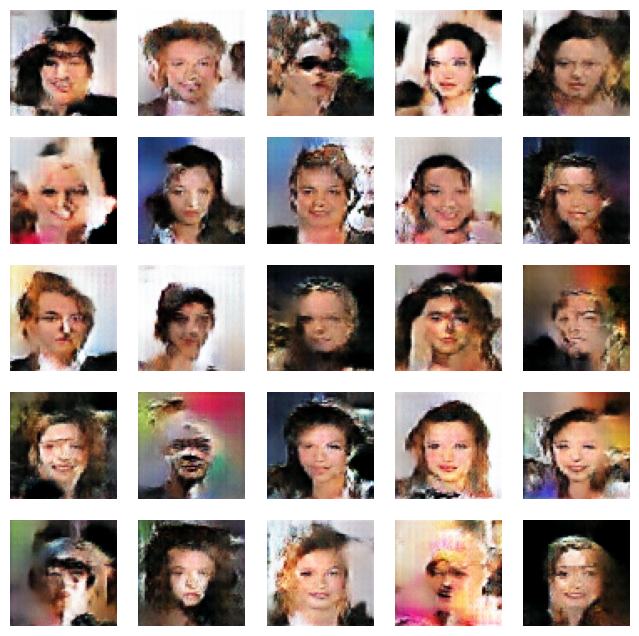

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7154 - g_loss: 0.7049
Epoch 9/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7082 - g_loss: 0.7030

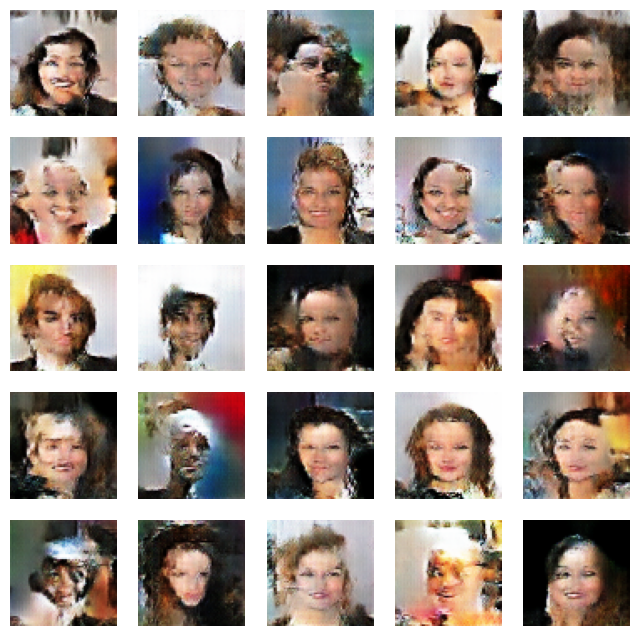

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7082 - g_loss: 0.7030
Epoch 10/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7070 - g_loss: 0.6995

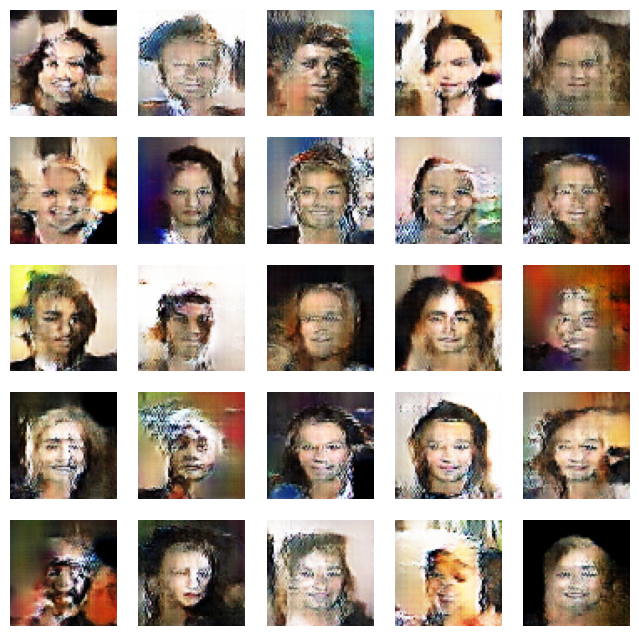

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7070 - g_loss: 0.6995
Epoch 11/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7033 - g_loss: 0.6975

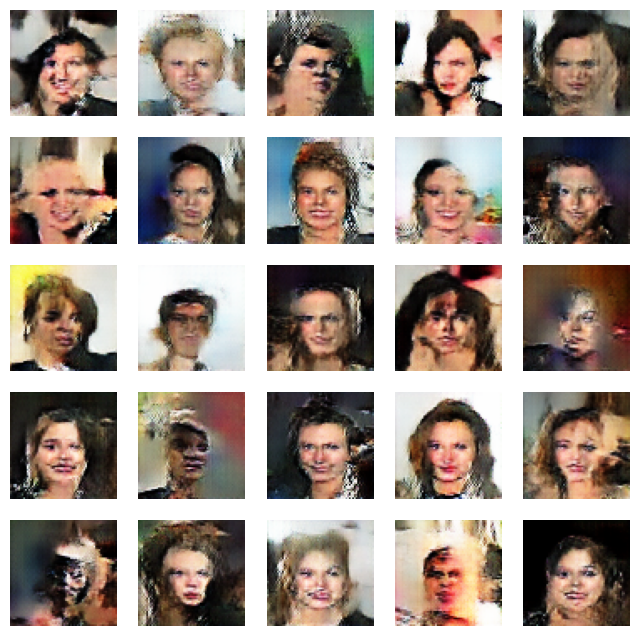

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7033 - g_loss: 0.6975
Epoch 12/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7032 - g_loss: 0.6932

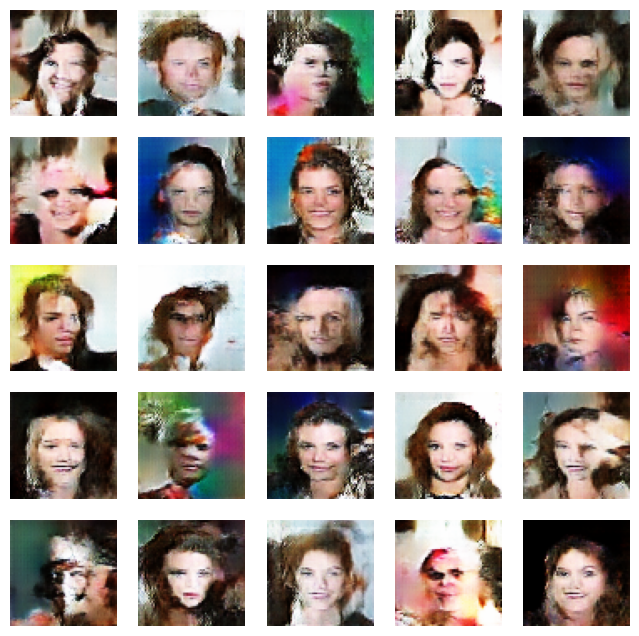

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7032 - g_loss: 0.6932
Epoch 13/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7017 - g_loss: 0.6923

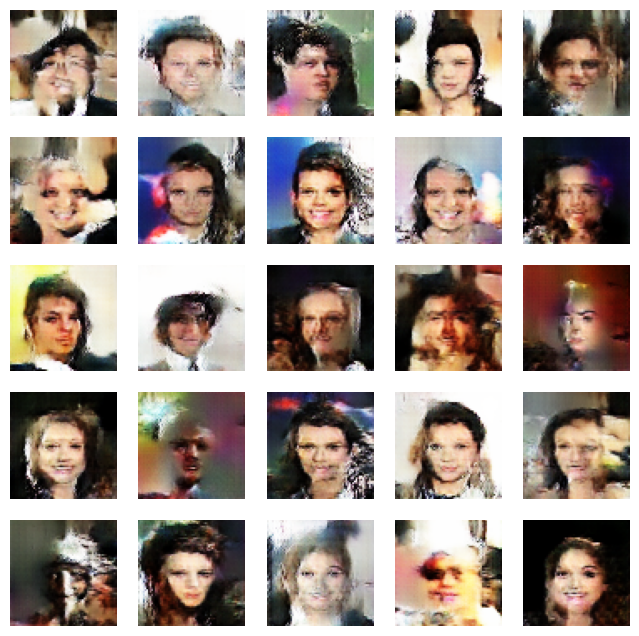

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7017 - g_loss: 0.6923
Epoch 14/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.7014 - g_loss: 0.6914

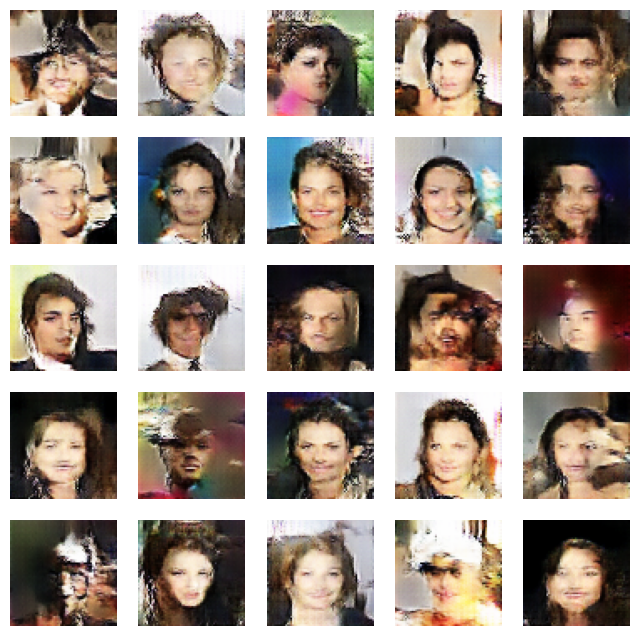

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.7014 - g_loss: 0.6914
Epoch 15/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6996 - g_loss: 0.6927

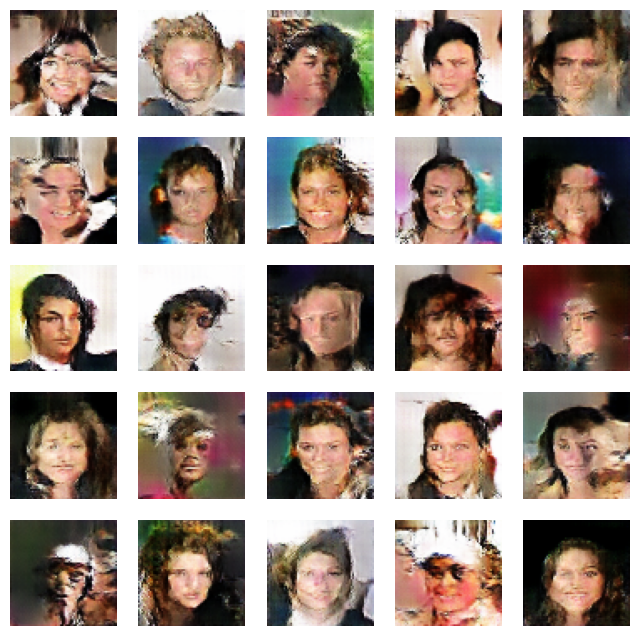

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6996 - g_loss: 0.6927
Epoch 16/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6983 - g_loss: 0.6919

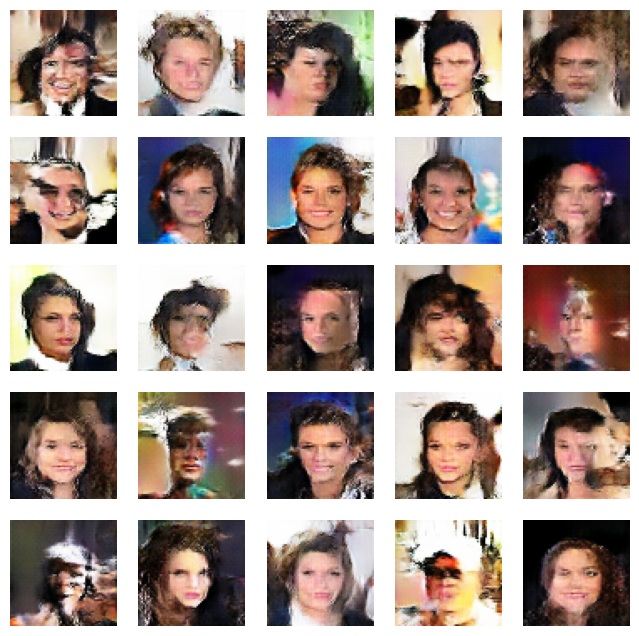

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6983 - g_loss: 0.6919
Epoch 17/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6974 - g_loss: 0.6938

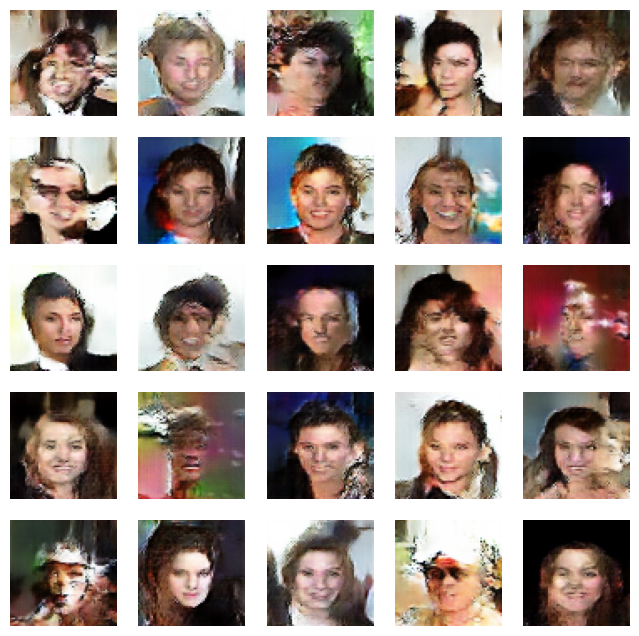

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6974 - g_loss: 0.6938
Epoch 18/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6970 - g_loss: 0.6946

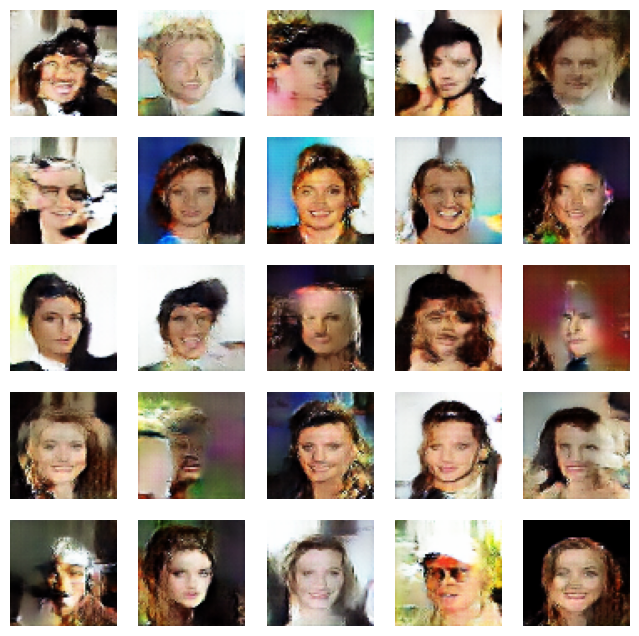

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6970 - g_loss: 0.6946
Epoch 19/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6965 - g_loss: 0.6954

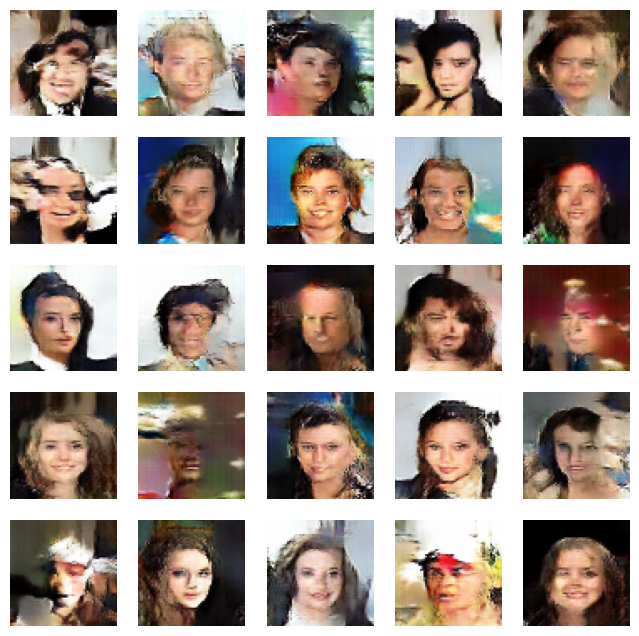

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6965 - g_loss: 0.6954
Epoch 20/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6954 - g_loss: 0.6965

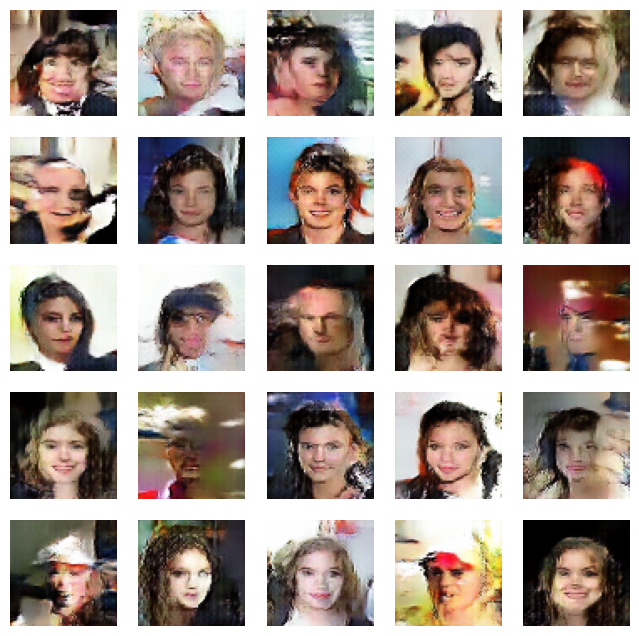

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6954 - g_loss: 0.6965
Epoch 21/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6948 - g_loss: 0.6994

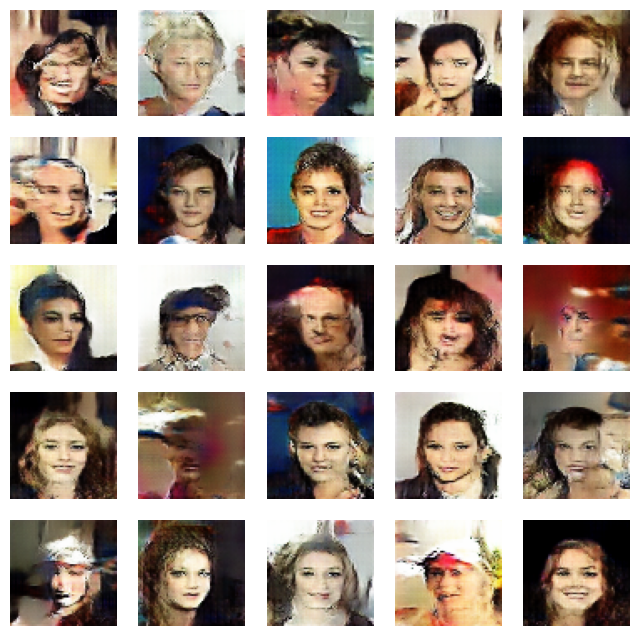

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6948 - g_loss: 0.6994
Epoch 22/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6953 - g_loss: 0.6979

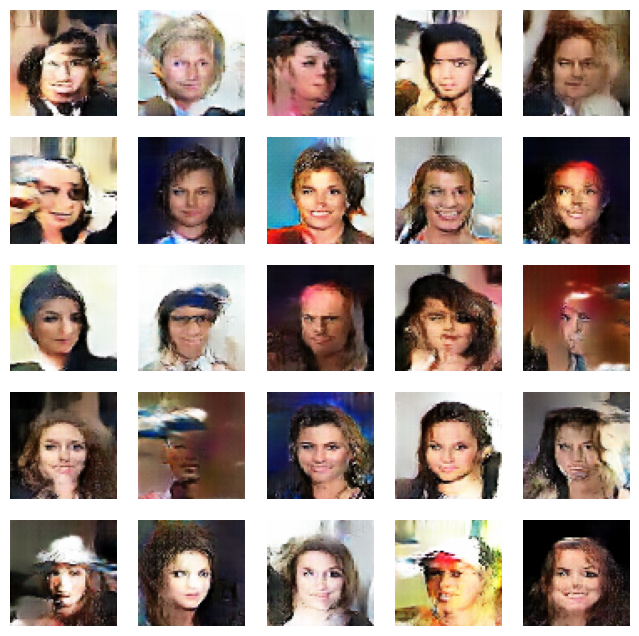

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6953 - g_loss: 0.6979
Epoch 23/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6931 - g_loss: 0.7017

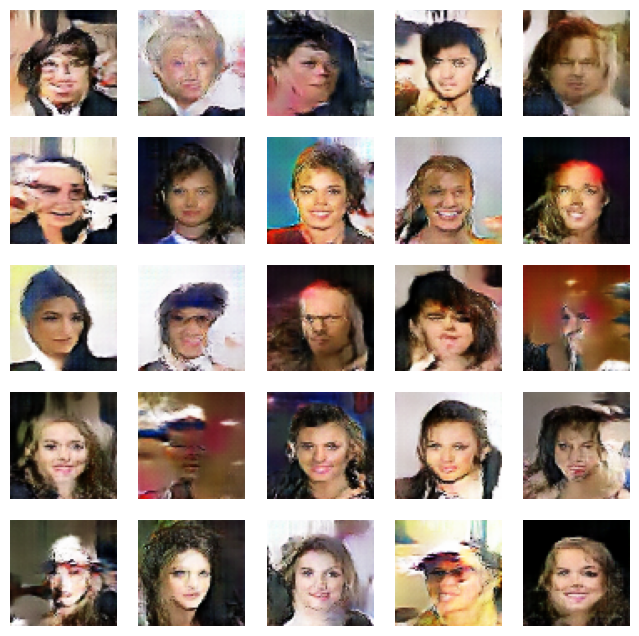

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6931 - g_loss: 0.7017
Epoch 24/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6916 - g_loss: 0.7087

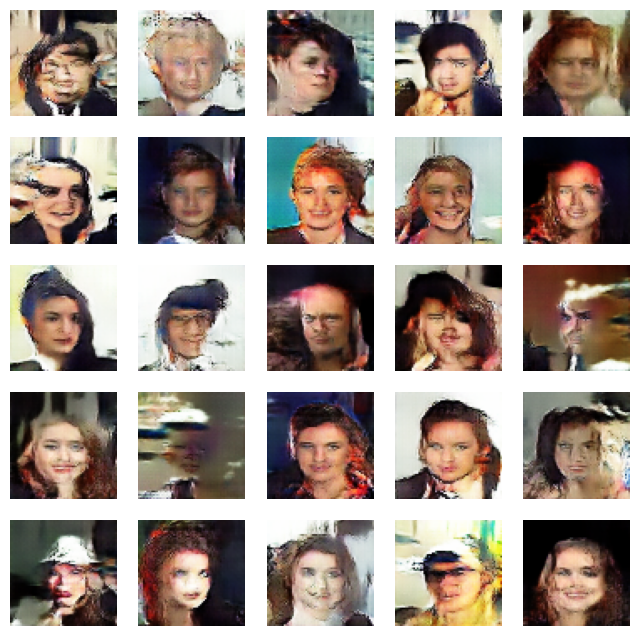

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6916 - g_loss: 0.7087
Epoch 25/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6898 - g_loss: 0.7160

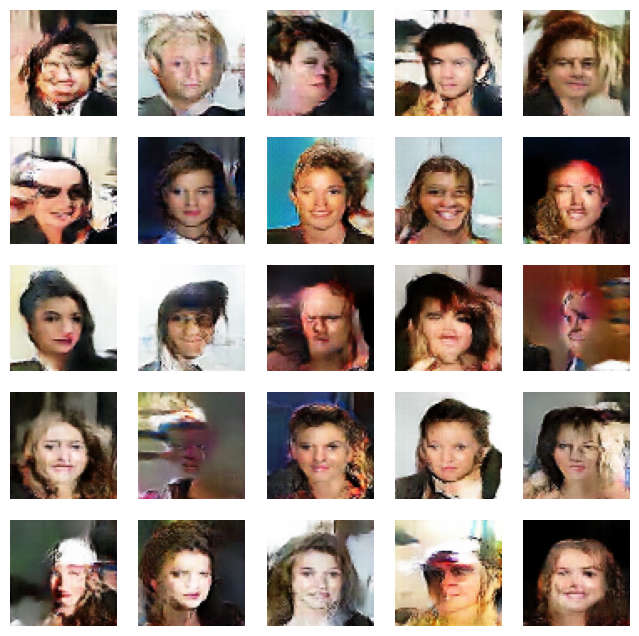

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6898 - g_loss: 0.7160
Epoch 26/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6873 - g_loss: 0.7224

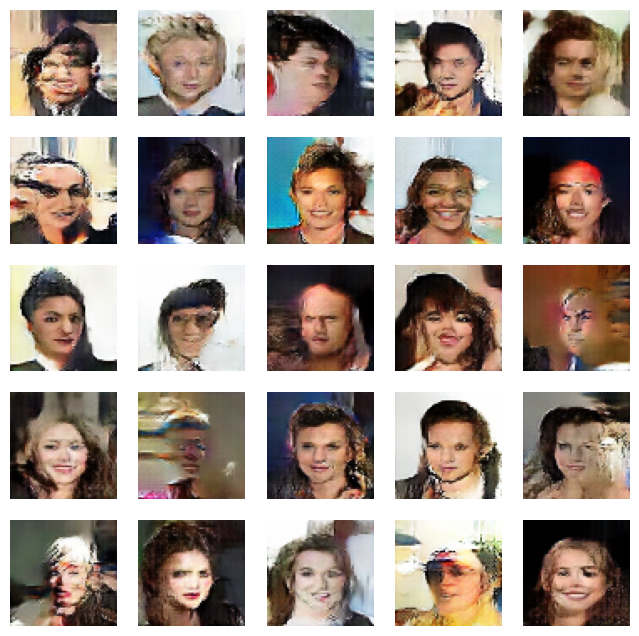

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6873 - g_loss: 0.7224
Epoch 27/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6830 - g_loss: 0.7360

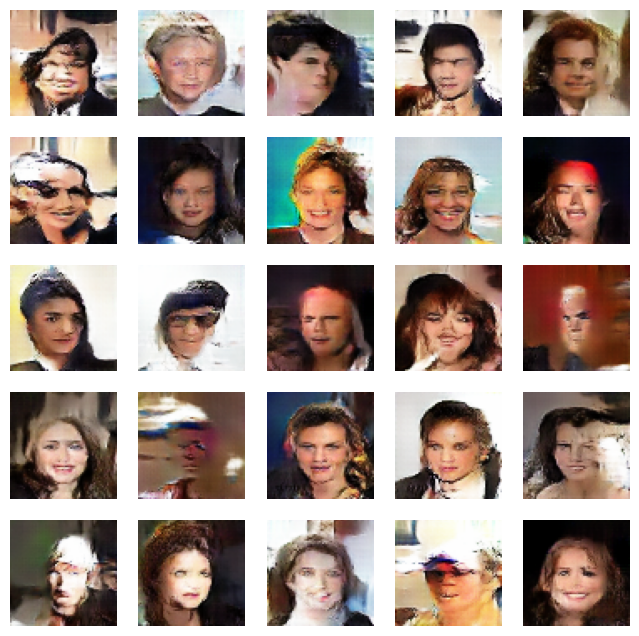

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6830 - g_loss: 0.7360
Epoch 28/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6779 - g_loss: 0.7555

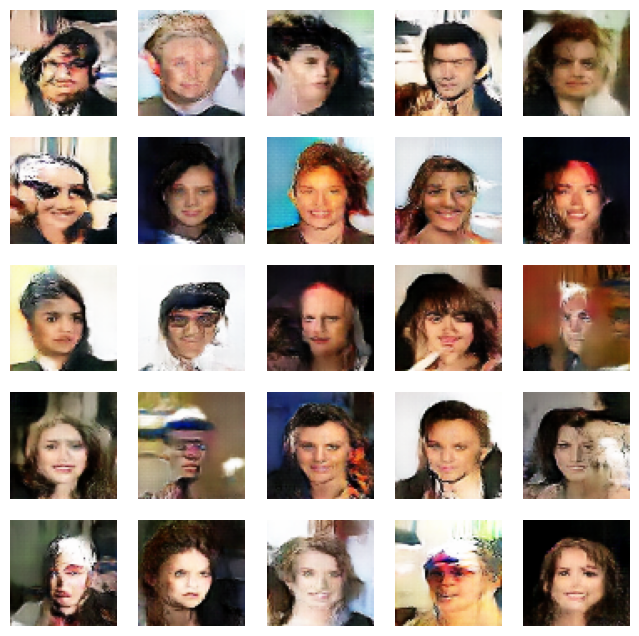

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6779 - g_loss: 0.7555
Epoch 29/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6718 - g_loss: 0.7761

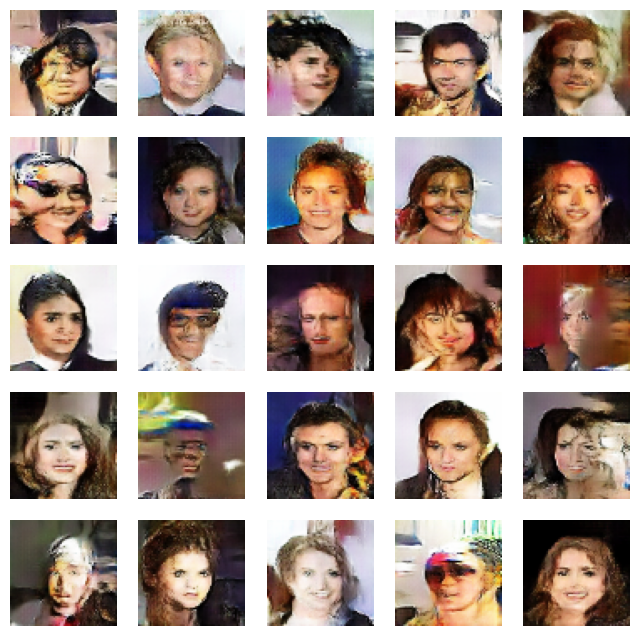

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6718 - g_loss: 0.7761
Epoch 30/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6622 - g_loss: 0.8101

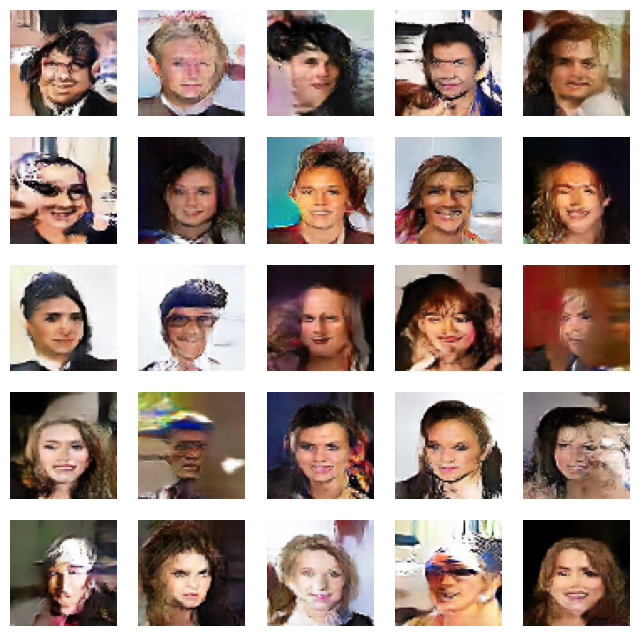

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6622 - g_loss: 0.8101
Epoch 31/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6519 - g_loss: 0.8413

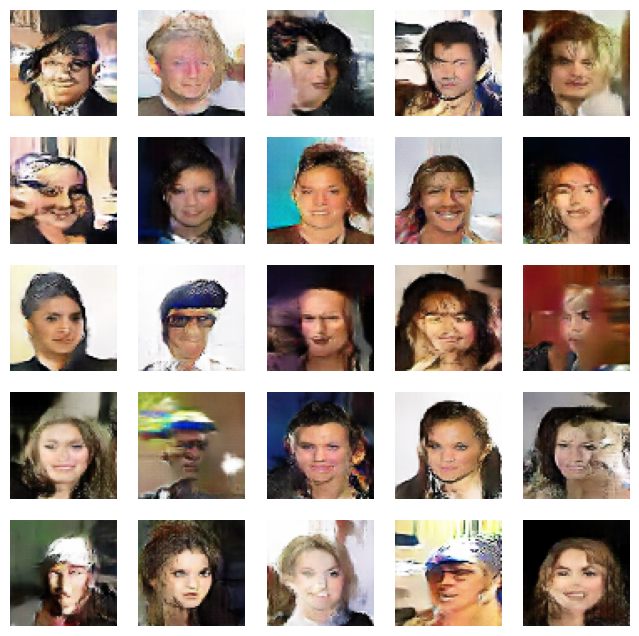

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6519 - g_loss: 0.8413
Epoch 32/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6403 - g_loss: 0.8825

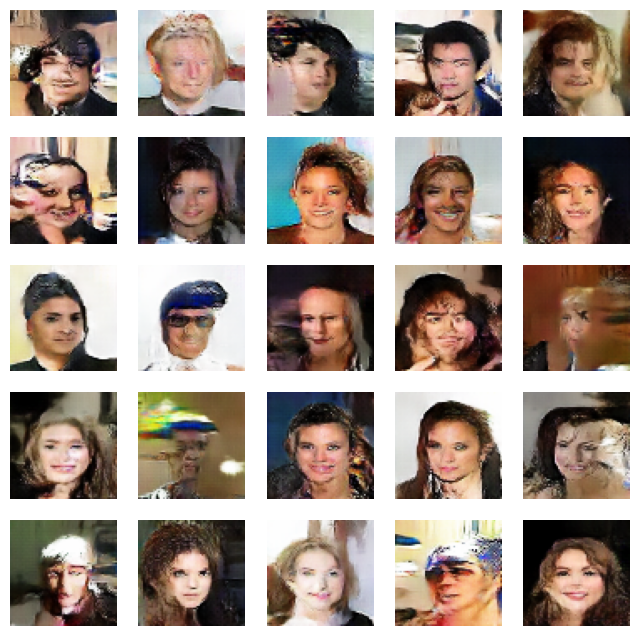

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6403 - g_loss: 0.8825
Epoch 33/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6293 - g_loss: 0.9199

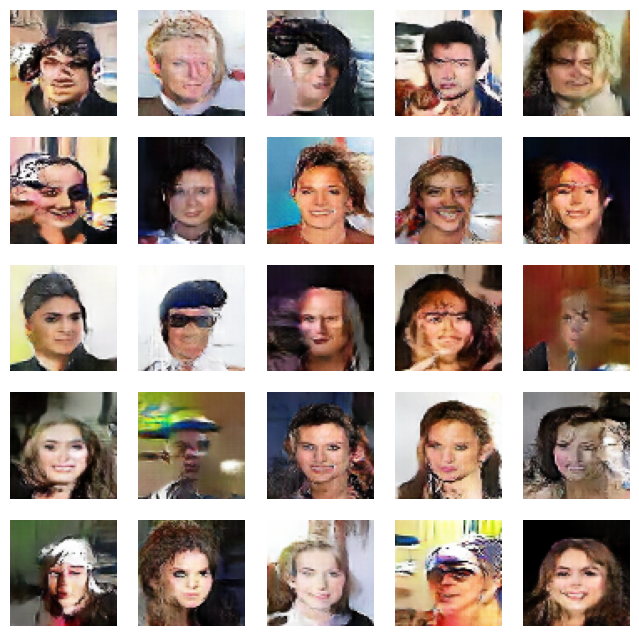

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6293 - g_loss: 0.9199
Epoch 34/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6206 - g_loss: 0.9549

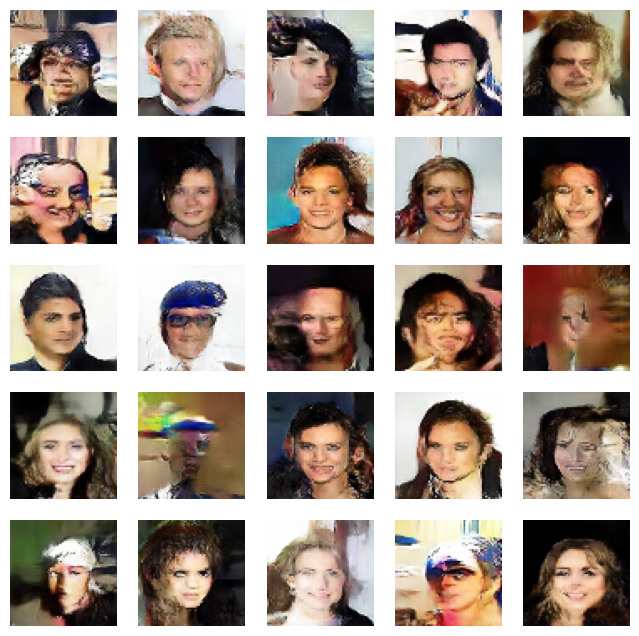

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6206 - g_loss: 0.9549
Epoch 35/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6100 - g_loss: 0.9965

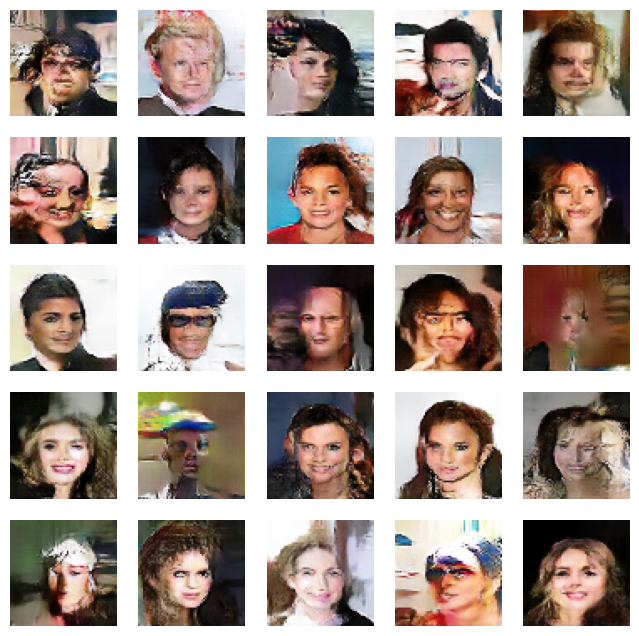

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6100 - g_loss: 0.9965
Epoch 36/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.6022 - g_loss: 1.0259

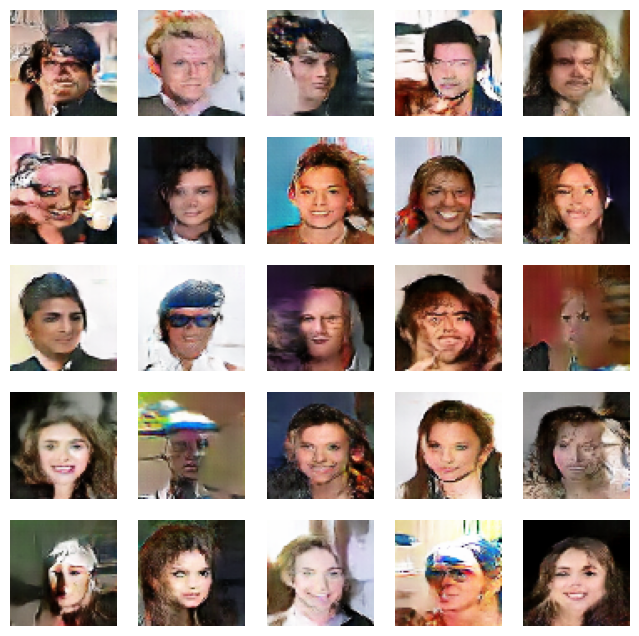

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.6022 - g_loss: 1.0259
Epoch 37/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5896 - g_loss: 1.0680

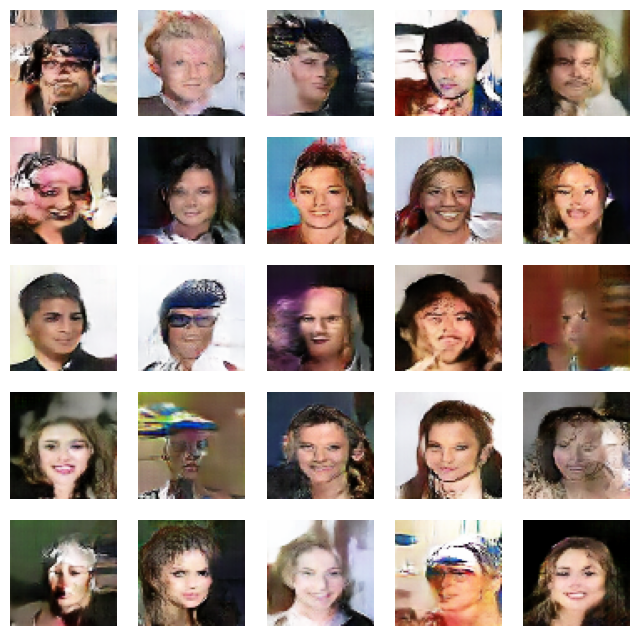

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5896 - g_loss: 1.0680
Epoch 38/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5811 - g_loss: 1.1133

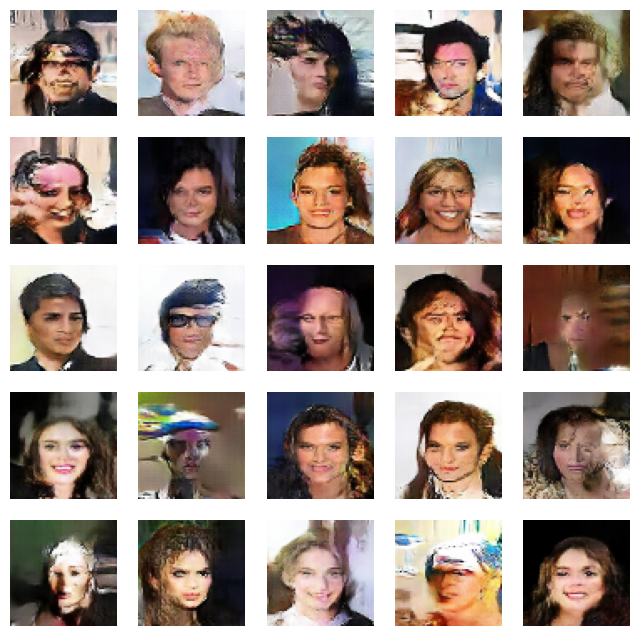

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5811 - g_loss: 1.1133
Epoch 39/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5757 - g_loss: 1.1448

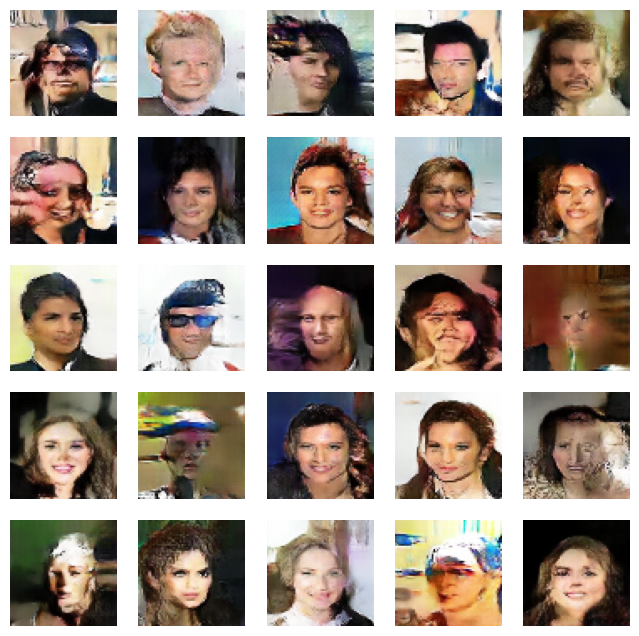

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5757 - g_loss: 1.1448
Epoch 40/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5654 - g_loss: 1.1826

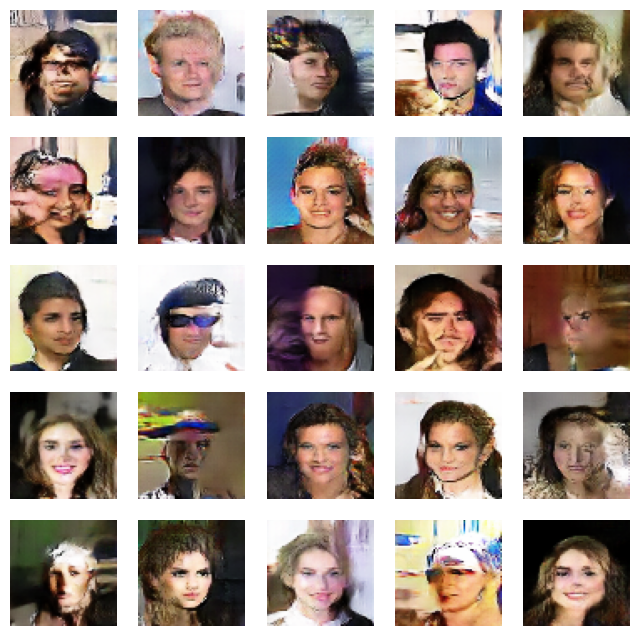

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5654 - g_loss: 1.1826
Epoch 41/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5563 - g_loss: 1.2280

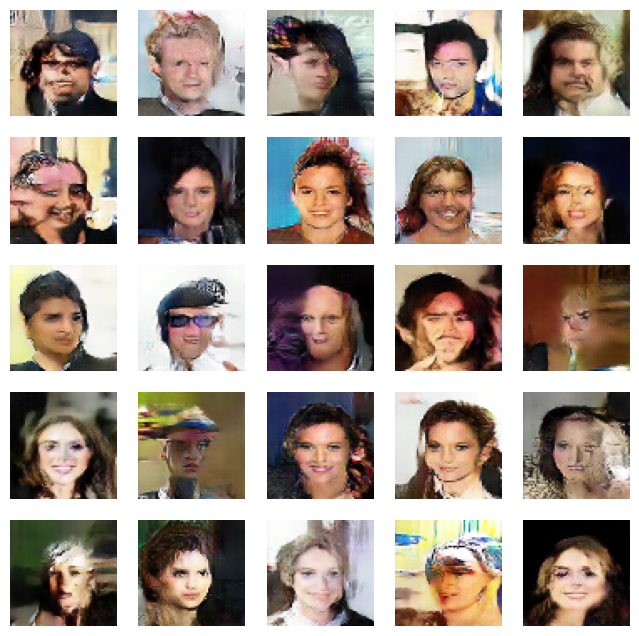

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5563 - g_loss: 1.2280
Epoch 42/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5516 - g_loss: 1.2569

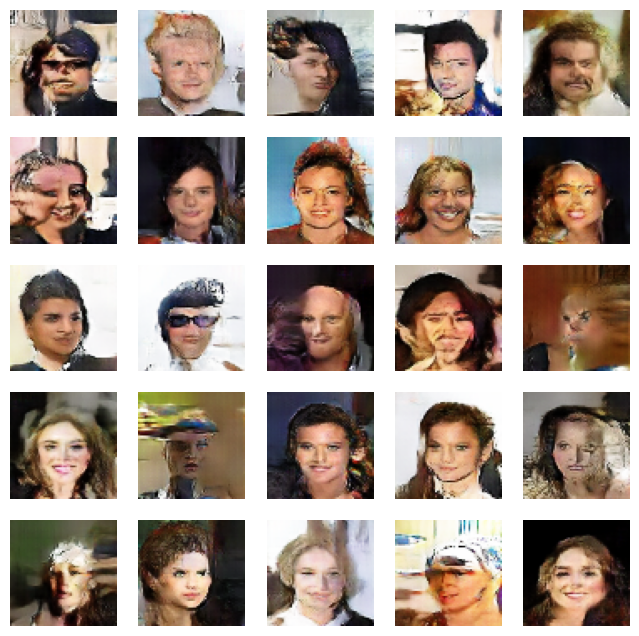

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5516 - g_loss: 1.2569
Epoch 43/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5445 - g_loss: 1.2815

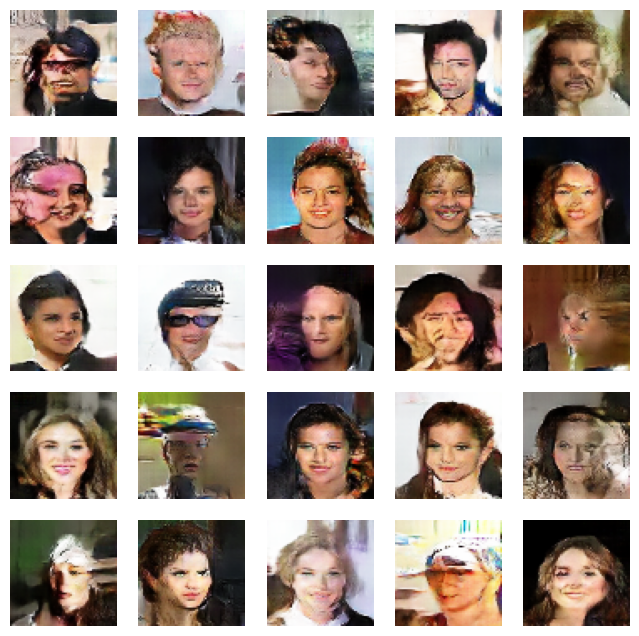

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5445 - g_loss: 1.2815
Epoch 44/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5389 - g_loss: 1.3191

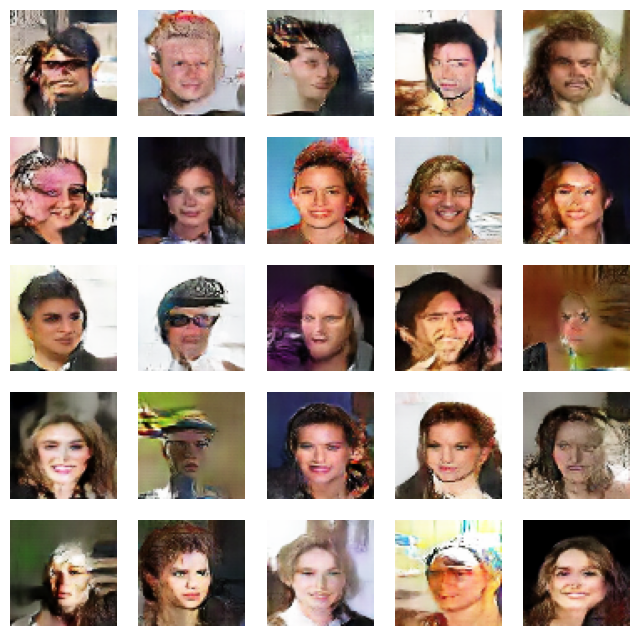

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5389 - g_loss: 1.3191
Epoch 45/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5325 - g_loss: 1.3463

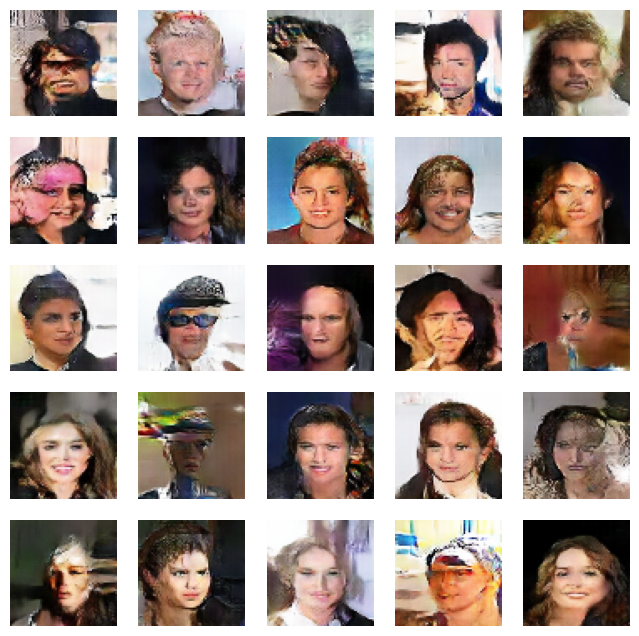

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5325 - g_loss: 1.3463
Epoch 46/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5296 - g_loss: 1.3642

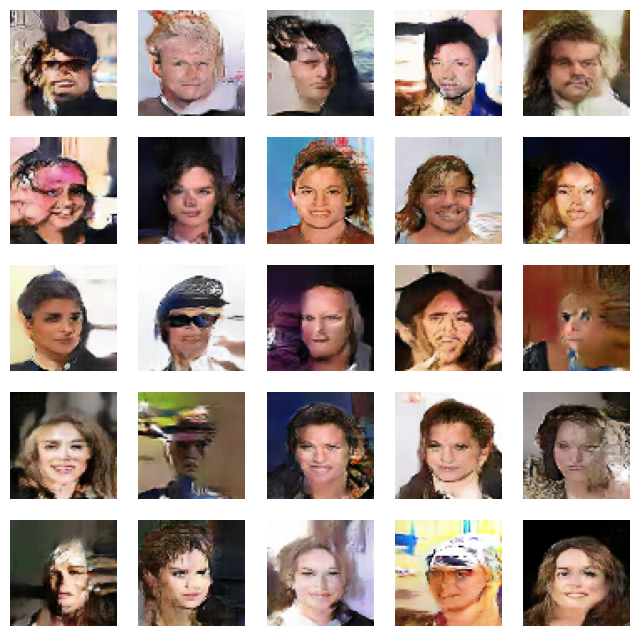

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5296 - g_loss: 1.3642
Epoch 47/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5304 - g_loss: 1.3845

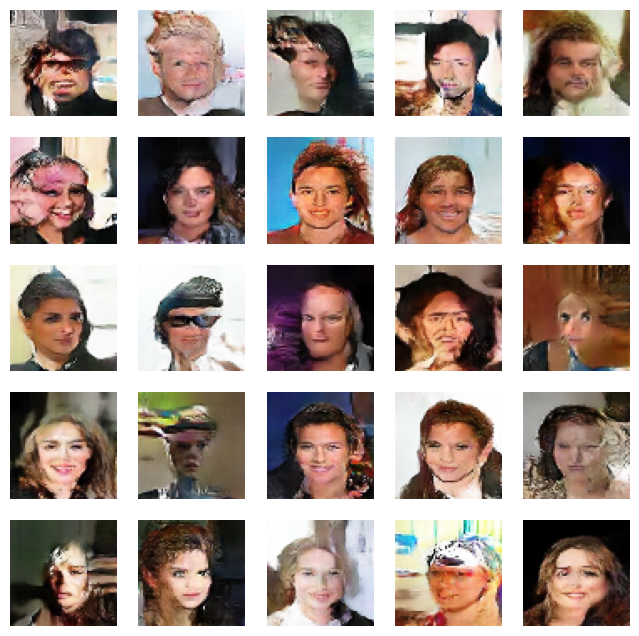

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5304 - g_loss: 1.3845
Epoch 48/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5179 - g_loss: 1.4246

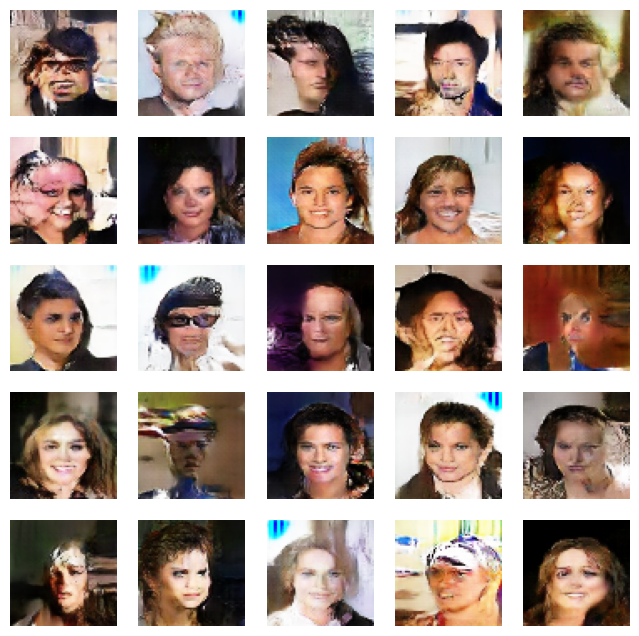

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5179 - g_loss: 1.4246
Epoch 49/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5165 - g_loss: 1.4526

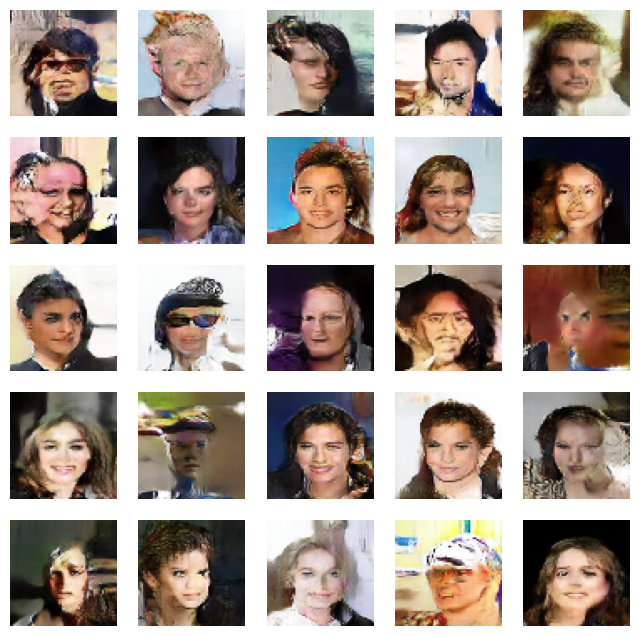

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5165 - g_loss: 1.4526
Epoch 50/50
1875/1875 [==============================] - ETA: 0s - d_loss: 0.5193 - g_loss: 1.4514

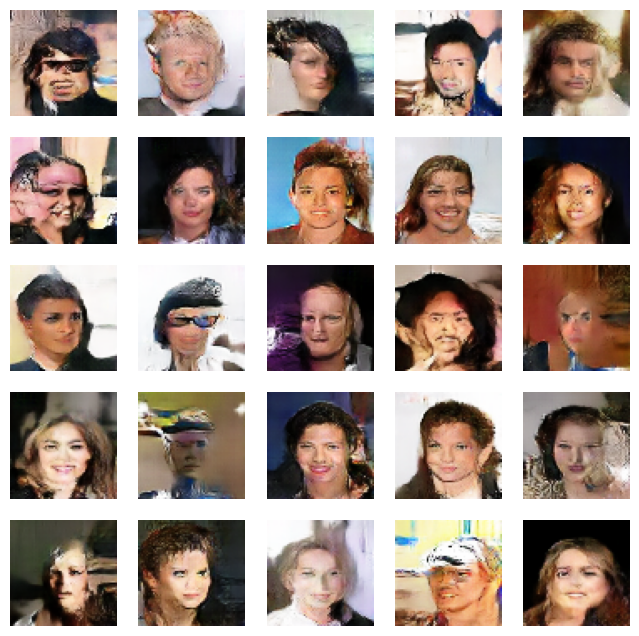

1875/1875 [==============================] - 115s 61ms/step - d_loss: 0.5193 - g_loss: 1.4514


In [12]:
N_EPOCHS = 50
dcgan.fit(X_Train, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])